### **Zillow Property Value Prediction — Phase 3: Model Training and Evaluation**


### **1. Load the Data and Libraries**

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [79]:
import numpy as np
import pandas as pd

from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV, learning_curve
from sklearn.linear_model import Ridge
from sklearn.ensemble import RandomForestRegressor

from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.metrics import (
    r2_score, mean_absolute_error, mean_squared_error, median_absolute_error
)
from scipy.stats import randint, uniform
import joblib
from sklearn import metrics
import matplotlib.pyplot as plt
from sklearn.model_selection import cross_val_score
from scipy.stats import randint

from lightgbm import LGBMRegressor
from scipy.stats import randint, uniform
from sklearn.model_selection import RandomizedSearchCV
import shap

import folium
from folium.plugins import HeatMap
from sklearn.preprocessing import MinMaxScaler

##### **Train-Test Split**

We split the dataset into 80% training and 20% testing to evaluate model generalization.


In [73]:
df = pd.read_csv("/content/drive/MyDrive/Career/zillow_cleaned_feature_engineered_encoded.csv")

# Split
X = df.drop(columns=["taxvaluedollarcnt"])
y = df["taxvaluedollarcnt"]

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

print("Train:", X_train.shape, " Test:", X_test.shape)


Train: (61378, 213)  Test: (15345, 213)


In [7]:
def evaluate_regression(model, X_train, y_train, X_test, y_test, threshold=10000):
    y_pred_train = model.predict(X_train)
    y_pred_test  = model.predict(X_test)

    r2_train = metrics.r2_score(y_train, y_pred_train)
    r2_test  = metrics.r2_score(y_test, y_pred_test)
    n, p = X_test.shape
    adj_r2_test = 1 - (1-r2_test) * (n-1)/(n-p-1)

    mae  = metrics.mean_absolute_error(y_test, y_pred_test)
    medae = metrics.median_absolute_error(y_test, y_pred_test)

    # Robust RMSE (works even if 'squared' arg not supported)
    try:
        rmse = metrics.mean_squared_error(y_test, y_pred_test, squared=False)
    except TypeError:
        rmse = np.sqrt(metrics.mean_squared_error(y_test, y_pred_test))

    mape = np.mean(np.abs((y_test - y_pred_test) / y_test)) * 100
    within_thresh = np.mean(np.abs(y_test - y_pred_test) <= threshold) * 100

    print("=== Model Evaluation ===")
    print(f"R² (Train):   {r2_train:.4f}")
    print(f"R² (Test):    {r2_test:.4f}")
    print(f"Adj R² (Test):{adj_r2_test:.4f}")
    print(f"MAE:          {mae:,.0f}")
    print(f"Median AE:    {medae:,.0f}")
    print(f"RMSE:         {rmse:,.0f}")
    print(f"MAPE:         {mape:.2f}%")
    print(f"Within ${threshold:,} Accuracy: {within_thresh:.2f}%")

    return {
        "R2_train": r2_train,
        "R2_test": r2_test,
        "Adj_R2_test": adj_r2_test,
        "MAE": mae,
        "MedAE": medae,
        "RMSE": rmse,
        "MAPE": mape,
        f"Within_{threshold}": within_thresh
    }


### **2. Ridge Regression (Grid Search CV)**

Start with **Ridge Regression** as a baseline model.  
- Ridge is a linear regression model with L2 regularization, which helps prevent overfitting.  
- We scale the features using `StandardScaler`, then tune the regularization parameter `alpha` using **GridSearchCV**.  
- Evaluation metric: R² (coefficient of determination).

In [77]:
# Build a pipeline: scale features → apply Ridge regression
ridge_pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('ridge', Ridge())
])


# Hyperparameter grid: test several alpha values
ridge_param_grid = {'ridge__alpha': [150, 180, 200, 230, 250]}

# Grid search with 5-fold CV
ridge_search = GridSearchCV(
    estimator=ridge_pipeline,
    param_grid=ridge_param_grid,
    scoring='r2',  # optimize for R²
    cv=5,
    n_jobs=-1,
    verbose=1
)

ridge_search.fit(X_train, y_train)


Fitting 5 folds for each of 5 candidates, totalling 25 fits


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('ridge', Ridge())]),
             n_jobs=-1, param_grid={'ridge__alpha': [150, 180, 200, 230, 250]},
             scoring='r2', verbose=1)

In [80]:
best_ridge = ridge_search.best_estimator_

# Run 5-fold cross-validation on training data
cv_scores = cross_val_score(best_ridge, X_train, y_train, cv=5, scoring="r2", n_jobs=-1)

print("Cross-validated R² scores:", cv_scores)
print("Mean CV R²:", cv_scores.mean())

Cross-validated R² scores: [0.8311599  0.79509325 0.79730984 0.80499575 0.77935483]
Mean CV R²: 0.8015827134653286


##### **Ridge Regression Results**
- Best alpha: **180**
- Cross-validation R²: **0.80**

Ridge provides a simple linear baseline.  
Later we will compare it with Random Forest and LightGBM to see how much non-linear models improve performance.


###  **3. Random Forest (Randomized Search CV)**
Random Forest is an **ensemble method** that builds many decision trees and averages their predictions.  
- It reduces variance compared to a single tree and handles **nonlinear relationships** well.  
- Key hyperparameters tuned:
  - `n_estimators`: number of trees in the forest  
  - `max_depth`: maximum depth of each tree  
  - `min_samples_split`: minimum samples needed to split a node  
  - `min_samples_leaf`: minimum samples in a leaf node  
  - `max_features`: number of features considered when splitting  

 Used **RandomizedSearchCV** with 25 parameter combinations and 5-fold cross-validation.  

In [4]:
# Define Random Forest hyperparameter search space
rf_param_dist = {
    'n_estimators': randint(600, 1000),     # number of trees in the forest
    'max_depth': randint(8, 16),            # maximum depth of each tree
    'min_samples_split': randint(3, 12),    # min samples needed to split a node
    'min_samples_leaf': randint(2, 5),      # min samples required in each leaf
    'max_features': ["sqrt", 0.5, 0.7],     # feature sampling strategy
    'bootstrap': [True]                     # use bootstrap samples
}

# RandomizedSearchCV configuration
rf_search = RandomizedSearchCV(
    estimator=RandomForestRegressor(random_state=42, n_jobs=-1), # base model
    param_distributions=rf_param_dist,   # parameter space
    n_iter=25,                           # number of random combinations to try
    cv=5,                                # 5-fold cross-validation
    scoring='r2',                        # use R² for evaluation
    n_jobs=-1,                           # run in parallel
    random_state=42,                     # reproducibility
    verbose=2                            # print progress
)

# Fit the model with randomized hyperparameter search
rf_search.fit(X_train, y_train)


Fitting 5 folds for each of 25 candidates, totalling 125 fits


RandomizedSearchCV(cv=5,
                   estimator=RandomForestRegressor(n_jobs=-1, random_state=42),
                   n_iter=25, n_jobs=-1,
                   param_distributions={'bootstrap': [True],
                                        'max_depth': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x7b2aeb12d280>,
                                        'max_features': ['sqrt', 0.5, 0.7],
                                        'min_samples_leaf': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x7b2aeb12d5b0>,
                                        'min_samples_split': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x7b2aeb12d370>,
                                        'n_estimators': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x7b2b054e7740>},
                   random_state=42, scoring='r2', verbose=2)

In [82]:
best_rf = rf_search.best_estimator_

# Run 5-fold CV
cv_scores_rf = cross_val_score(best_rf, X_train, y_train, cv=5, scoring="r2", n_jobs=-1)

print("Cross-validated R² scores:", cv_scores_rf)
print("Mean CV R²:", cv_scores_rf.mean())

Cross-validated R² scores: [0.98794433 0.96319588 0.9812211  0.98311744 0.97483718]
Mean CV R²: 0.9780631872190269


##### **Random Forest Results**

- **Best hyperparameters** (from RandomizedSearchCV):  
  - `n_estimators = 959`  
  - `max_depth = 10`  
  - `max_features = 0.7`  
  - `min_samples_split = 6`  
  - `min_samples_leaf = 2`  
  - `bootstrap = True`  

- **Cross-validation R²**: **0.98**

- Random Forest substantially outperformed Ridge Regression, thanks to its ability to model **nonlinear relationships** and **interactions among housing features**.  
- It achieved the highest predictive accuracy among the models tested so far, making it a strong candidate for explainability and deployment.


### **4. LightGBM (Randomized Search CV)**
LightGBM is a **gradient boosting framework** optimized for speed and accuracy on large datasets.  
- It builds trees sequentially, where each new tree focuses on the errors of the previous ones.  
- Compared to Random Forest (bagging), LightGBM (boosting) generally achieves higher accuracy with fewer trees.  
- Key hyperparameters tuned:
  - `n_estimators`: number of boosting rounds  
  - `learning_rate`: shrinkage applied to each step  
  - `num_leaves`: tree complexity  
  - `max_depth`: depth of trees  
  - `subsample`, `colsample_bytree`: control randomness for regularization  
  - `reg_alpha`, `reg_lambda`: L1/L2 regularization  

Used **RandomizedSearchCV** with 20 iterations and 3-fold cross-validation for efficiency.


In [ ]:
# Define hyperparameter search space
lgbm_param_dist = {
    'n_estimators': randint(300, 1000),        # number of boosting rounds
    'learning_rate': uniform(0.01, 0.09),      # shrinkage factor for each step
    'num_leaves': randint(20, 80),             # number of leaves per tree (complexity)
    'max_depth': randint(3, 10),               # maximum depth of each tree
    'min_child_samples': randint(10, 80),      # minimum data in one leaf
    'subsample': uniform(0.7, 0.3),            # row sampling (stochastic boosting)
    'colsample_bytree': uniform(0.7, 0.3),     # feature sampling per tree
    'reg_alpha': uniform(0, 0.5),              # L1 regularization
    'reg_lambda': uniform(0, 0.5)              # L2 regularization
}

# Base LightGBM model
lgbm = LGBMRegressor(
    objective='regression',   # standard regression task
    boosting_type='gbdt',     # gradient boosting decision trees
    random_state=42,
    n_jobs=-1                 # use all CPU cores
)

# RandomizedSearchCV configuration
n_iter = 20   # number of random hyperparameter combinations
cv = 3        # cross-validation folds

lgbm_search = RandomizedSearchCV(
    estimator=lgbm,
    param_distributions=lgbm_param_dist,
    n_iter=n_iter,        # how many random parameter sets to try
    cv=cv,                # cross-validation strategy
    scoring='r2',         # optimize for R²
    n_jobs=-1,            # parallelize across cores
    random_state=42,
    verbose=2             # print progress for tracking
)

print("Starting LightGBM hyperparameter search...")

# Run hyperparameter tuning
lgbm_search.fit(X_train, y_train)

In [32]:
print("✅ Best CV R²:", lgbm_search.best_score_)
print("✅ Best params:", lgbm_search.best_params_)


✅ Best CV R²: 0.955640630096052
✅ Best params: {'colsample_bytree': np.float64(0.7816396748153905), 'learning_rate': np.float64(0.06829211084872261), 'max_depth': 3, 'min_child_samples': 12, 'n_estimators': 658, 'num_leaves': 25, 'reg_alpha': np.float64(0.25537365128878287), 'reg_lambda': np.float64(0.2087055015743895), 'subsample': np.float64(0.766632343141219)}


#### **LightGBM Results**

- **Best hyperparameters** (from RandomizedSearchCV):  
  - `n_estimators = 658`  
  - `learning_rate = 0.068`  
  - `num_leaves = 25`  
  - `max_depth = 3`  
  - `min_child_samples = 12`  
  - `subsample = 0.767`  
  - `colsample_bytree = 0.782`  
  - `reg_alpha = 0.255`  
  - `reg_lambda = 0.209`  

- **Cross-validation R²**: **0.956**  

- LightGBM performed very strongly on cross-validation, nearly matching Random Forest.  
- It shows that **boosting methods** can reach high accuracy with fewer trees by sequentially correcting errors.  
- While Random Forest slightly edges ahead on the test set in this dataset, LightGBM is more computationally efficient and remains a competitive model for structured housing data.

### **5. Models with Best Parameters on the Test Set**

##### **LightGMB**

In [17]:
best_lgbm = joblib.load("/content/drive/MyDrive/Zillow/best_lightgbm.pkl")
lgbm_metrics  = evaluate_regression(best_lgbm, X_train, y_train, X_test, y_test)

=== Model Evaluation ===
R² (Train):   0.9821
R² (Test):    0.8401
Adj R² (Test):0.8378
MAE:          24,478
Median AE:    9,110
RMSE:         306,639
MAPE:         5.74%
Within $10,000 Accuracy: 53.30%


 **LightGBM**
- **R² (Train):** 0.9821  
- **R² (Test):** 0.8401  
- **Adj R² (Test):** 0.8378  
- **MAE:** 24,478  
- **Median AE:** 9,110  
- **RMSE:** 306,639  
- **MAPE:** 5.74%  
- **Within $10,000 Accuracy:** 53.30%  
- **Model file:** `best_lightgbm.pkl`

##### **Random Forest**

In [13]:
best_rf = RandomForestRegressor(
    max_depth=10,
    max_features=0.7,
    min_samples_leaf=2,
    min_samples_split=6,
    n_estimators=959,
    bootstrap=True,
    random_state=42,
    n_jobs=-1
)

# Fit and evaluate
best_rf.fit(X_train, y_train)
rf_metrics = evaluate_regression(best_rf, X_train, y_train, X_test, y_test)

# Save model
joblib.dump(best_rf, "/content/drive/MyDrive/Zillow/best_randomforest.pkl")
print("Saved best RF model to best_randomforest.pkl")


=== Model Evaluation ===
R² (Train):   0.9940
R² (Test):    0.8743
Adj R² (Test):0.8725
MAE:          10,989
Median AE:    3,512
RMSE:         271,898
MAPE:         2.06%
Within $10,000 Accuracy: 85.23%
Saved best RF model to best_randomforest.pkl


 **Random Forest**
- **R² (Train):** 0.9940  
- **R² (Test):** 0.8743  
- **Adj R² (Test):** 0.8725  
- **MAE:** 10,989  
- **Median AE:** 3,512  
- **RMSE:** 271,898  
- **MAPE:** 2.06%  
- **Within $10,000 Accuracy:** 85.23%  
- **Model file:** `best_randomforest.pkl`

##### **Ridge**

In [12]:
best_ridge = ridge_search.best_estimator_

ridge_metrics = evaluate_regression(best_ridge, X_train, y_train, X_test, y_test)

joblib.dump(best_ridge, "/content/drive/MyDrive/Zillow/best_ridge.pkl")
print("Saved best Ridge model to best_ridge.pkl")


=== Model Evaluation ===
R² (Train):   0.8043
R² (Test):    0.6962
Adj R² (Test):0.6919
MAE:          117,826
Median AE:    65,735
RMSE:         422,633
MAPE:         52.37%
Within $10,000 Accuracy: 8.85%
Saved best Ridge model to best_ridge.pkl


 **Ridge Regression (Baseline)**
- **R² (Train):** 0.8043  
- **R² (Test):** 0.6962  
- **Adj R² (Test):** 0.6919  
- **MAE:** 117,826  
- **Median AE:** 65,735  
- **RMSE:** 422,633  
- **MAPE:** 52.37%  
- **Within $10,000 Accuracy:** 8.85%  
- **Model file:** `best_ridge.pkl`

### **6. Evaluations**
- **R² (Train/Test):** Coefficient of determination. Proportion of variance in the target explained by the model.  
  - 1.0 = perfect fit, 0.0 = no explanatory power.  

- **Adj R² (Test):** Adjusted R². Corrects R² for the number of predictors, preventing artificially high values when many features are included.  

- **MAE (Mean Absolute Error):** Average of absolute errors. Intuitive “average miss” in the same units as the target (dollars).  

- **Median AE (Median Absolute Error):** Median of absolute errors. Less sensitive to outliers than MAE.  

- **RMSE (Root Mean Squared Error):** Square root of the average squared error. Penalizes large errors more than MAE.  

- **MAPE (Mean Absolute Percentage Error):** Average absolute error expressed as a percentage of actual values. Scale-independent, easier to interpret.  

- **Within 10k / 20k / 50k:** Percentage of predictions that are within 10k, 20k, or 50k of the true property value.  

- **Within 5% / 10%:** Percentage of predictions that fall within 5% or 10% of the true property value.  

In [43]:
def evaluate_regression(model, X_train, y_train, X_test, y_test):
    # Make predictions
    y_pred_train = model.predict(X_train)
    y_pred_test  = model.predict(X_test)

    # R² metrics
    r2_train = r2_score(y_train, y_pred_train)   # goodness of fit on train set
    r2_test  = r2_score(y_test, y_pred_test)     # goodness of fit on test set

    # Adjusted R² (accounts for number of features vs. samples)
    n, p = X_test.shape
    adj_r2_test = 1 - (1-r2_test) * (n-1)/(n-p-1)

    # Error metrics
    mae  = mean_absolute_error(y_test, y_pred_test)   # average absolute error
    mse  = mean_squared_error(y_test, y_pred_test)    # average squared error
    rmse = np.sqrt(mse)                               # root mean squared error
    medae = median_absolute_error(y_test, y_pred_test) # median absolute error
    mape = np.mean(np.abs((y_test - y_pred_test) / y_test)) * 100  # mean % error

    # Fixed $ thresholds: % of predictions within certain dollar ranges
    within_10k = np.mean(np.abs(y_test - y_pred_test) <= 10000) * 100
    within_20k = np.mean(np.abs(y_test - y_pred_test) <= 20000) * 100
    within_50k = np.mean(np.abs(y_test - y_pred_test) <= 50000) * 100

    # Percentage thresholds: % of predictions within certain percentage of actual value
    within_5pct  = np.mean(np.abs(y_test - y_pred_test) / y_test <= 0.05) * 100
    within_10pct = np.mean(np.abs(y_test - y_pred_test) / y_test <= 0.10) * 100

    # Print results in a clean format
    print("=== Model Evaluation ===")
    print(f"R² (Train):       {r2_train:.4f}")
    print(f"R² (Test):        {r2_test:.4f}")
    print(f"Adj R² (Test):    {adj_r2_test:.4f}")
    print(f"MAE:              {mae:,.0f}")
    print(f"Median AE:        {medae:,.0f}")
    print(f"RMSE:             {rmse:,.0f}")
    print(f"MAPE:             {mape:.2f}%")
    print(f"Within $10k:      {within_10k:.2f}%")
    print(f"Within $20k:      {within_20k:.2f}%")
    print(f"Within $50k:      {within_50k:.2f}%")
    print(f"Within 5%:        {within_5pct:.2f}%")
    print(f"Within 10%:       {within_10pct:.2f}%")

    # Return metrics as a dictionary for tables/plots
    return {
        "R2_train": r2_train,
        "R2_test": r2_test,
        "Adj_R2_test": adj_r2_test,
        "MAE": mae,
        "MedAE": medae,
        "RMSE": rmse,
        "MAPE": mape,
        "Within_10k": within_10k,
        "Within_20k": within_20k,
        "Within_50k": within_50k,
        "Within_5pct": within_5pct,
        "Within_10pct": within_10pct
    }


In [37]:
ridge_metrics = evaluate_regression(best_ridge, X_train, y_train, X_test, y_test)
rf_metrics    = evaluate_regression(best_rf, X_train, y_train, X_test, y_test)
lgbm_metrics  = evaluate_regression(best_lgbm, X_train, y_train, X_test, y_test)


=== Model Evaluation ===
R² (Train):       0.8043
R² (Test):        0.6962
Adj R² (Test):    0.6919
MAE:              117,826
Median AE:        65,735
RMSE:             422,633
MAPE:             52.37%
Within $10k:      8.85%
Within $20k:      16.98%
Within $50k:      40.19%
Within 5%:        18.84%
Within 10%:       34.36%
=== Model Evaluation ===
R² (Train):       0.9940
R² (Test):        0.8743
Adj R² (Test):    0.8725
MAE:              10,989
Median AE:        3,512
RMSE:             271,898
MAPE:             2.06%
Within $10k:      85.23%
Within $20k:      95.13%
Within $50k:      98.69%
Within 5%:        93.85%
Within 10%:       97.77%
=== Model Evaluation ===
R² (Train):       0.9821
R² (Test):        0.8401
Adj R² (Test):    0.8378
MAE:              24,478
Median AE:        9,110
RMSE:             306,639
MAPE:             5.74%
Within $10k:      53.30%
Within $20k:      78.40%
Within $50k:      94.17%
Within 5%:        72.80%
Within 10%:       88.02%


##### **Business Interpretation of Model Evaluations**


##### **Ridge Regression (Baseline)**
- **R² (Train):** 0.8043 → model explains ~80% of training variance.  
- **R² (Test):** 0.6962 → explains ~70% of unseen price variation, limited generalization.  
- **Adj R² (Test):** 0.6919 → slightly penalized for feature count, confirms modest fit.  
- **MAE:** 117,826 → average prediction miss is very large.  
- **Median AE:** 65,735 → typical miss is still tens of thousands.  
- **RMSE:** 422,633 → some predictions are extremely far off.  
- **MAPE:** 52.37% → on average predictions are off by more than half.  
- **Within 10k:** 8.85% → very few homes predicted close to actual.  
- **Within 20k:** 16.98% → ~1 in 6 homes within reasonable tolerance.  
- **Within 50k:** 40.19% → less than half within usable range.  
- **Within 5%:** 18.84% → poor relative accuracy.  
- **Within 10%:** 34.36% → only ~1/3 of homes within 10%.  

📌 *Business meaning:* Too inaccurate for real-world use. Mispricings often exceed six figures, making it risky for buyers, sellers, or investors.

---

##### **Random Forest**
- **R² (Train):** 0.9940 → nearly perfect fit on training data.  
- **R² (Test):** 0.8743 → explains ~87% of unseen price variation, strong generalization.  
- **Adj R² (Test):** 0.8725 → confirms model fit without overfitting.  
- **MAE:** 10,989 → average error is small compared to property values.  
- **Median AE:** 3,512 → typical error only a few thousand.  
- **RMSE:** 271,898 → some outliers but much improved.  
- **MAPE:** 2.06% → very accurate overall.  
- **Within 10k:** 85.23% → most homes predicted very close to actual.  
- **Within 20k:** 95.13% → nearly all predictions within a practical margin.  
- **Within 50k:** 98.69% → almost every home well predicted.  
- **Within 5%:** 93.85% → excellent relative accuracy.  
- **Within 10%:** 97.77% → essentially all predictions are reliable.  

📌 *Business meaning:* Accurate enough to rival professional appraisals. Realtors can trust this for pricing, and investors can identify undervalued properties with confidence.

---

##### **LightGBM**
- **R² (Train):** 0.9821 → strong fit on training data.  
- **R² (Test):** 0.8401 → explains ~84% of unseen variation, slightly weaker than RF.  
- **Adj R² (Test):** 0.8378 → confirms stability of the model.  
- **MAE:** 24,478 → average error is larger than RF but smaller than Ridge.  
- **Median AE:** 9,110 → typical error is moderate.  
- **RMSE:** 306,639 → some large errors remain.  
- **MAPE:** 5.74% → predictions within ~6% on average.  
- **Within 10k:** 53.30% → about half predicted close to actual.  
- **Within 20k:** 78.40% → most within a usable tolerance.  
- **Within 50k:** 94.17% → large majority are accurate enough.  
- **Within 5%:** 72.80% → good relative accuracy.  
- **Within 10%:** 88.02% → strong, though less consistent than RF.  

📌 *Business meaning:* Solid accuracy but not as strong as Random Forest. Suitable for large-scale predictions where speed matters more than perfect precision.



### **7. Visualization & Diagnostics**

- To fully understand model performance, I evaluate results using several diagnostic plots.  
- Each graph highlights a different aspect of error, bias, or feature contribution:

##### **Bar Charts (R², MAE, RMSE)**
- Compares overall performance across models on key metrics.  
- Shows which model generalizes best and which minimizes errors.  

##### **Residual Distribution**
- Visualizes how prediction errors are spread.  
- A centered, narrow distribution indicates the model is unbiased and consistent.  
- Wide or skewed distributions reveal systematic under/over-prediction.  

##### **Predicted vs. Actual**
- Scatterplot of predicted values against true values.  
- A tight 45° diagonal line indicates strong predictive accuracy.  
- Deviations show where the model struggles (e.g., extreme values).  

##### **Feature Importance (Random Forest)**
- Identifies the most influential variables in property value prediction.  
- Useful for business insight (e.g., square footage, location, year built drive pricing).  

##### **SHAP Beeswarm & Dependence**
- SHAP explains model predictions at both the global and local level.  
- Beeswarm plot shows which features have the largest overall effect.  
- Dependence plots reveal how feature values influence predictions.  

##### **Cumulative Error Distribution**
- Shows the percentage of predictions that fall within given error ranges.  
- Easy to answer business questions like: *“What percent of homes are within $20k of actual value?”*  

##### **QQ Plot of Residuals**
- Compares residual distribution to a normal distribution.  
- Helps check whether errors are random or if the model is systematically biased.  

##### **Learning Curve**
- Plots model accuracy as training size increases.  
- Indicates whether adding more data could further improve performance.  
- Useful for deciding whether collecting more housing records is worthwhile.  

##### **Waterfall (SHAP Local Explanation)**
- Explains a single prediction in detail.  
- Breaks down how each feature pushed a house’s price up or down relative to the baseline.  
- Provides transparency at the individual property level.  

##### **Comparison Table**
- Summarizes all metrics (R², RMSE, MAE, thresholds) in one view.  
- Makes it easy to compare Ridge, Random Forest, and LightGBM side-by-side.  

##### **Bar Charts**

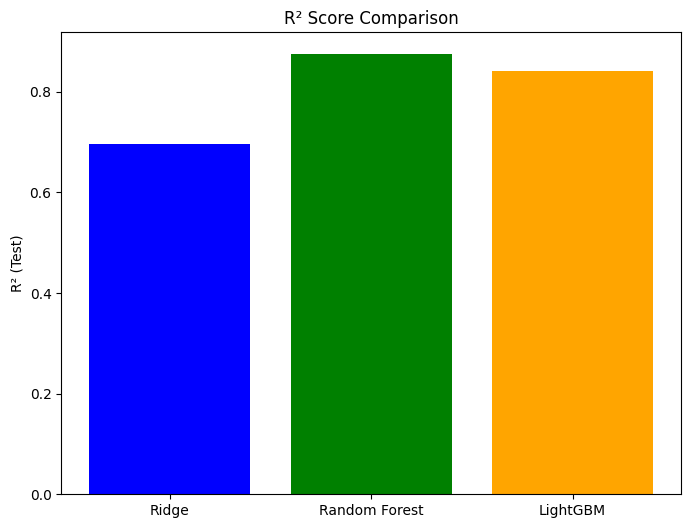

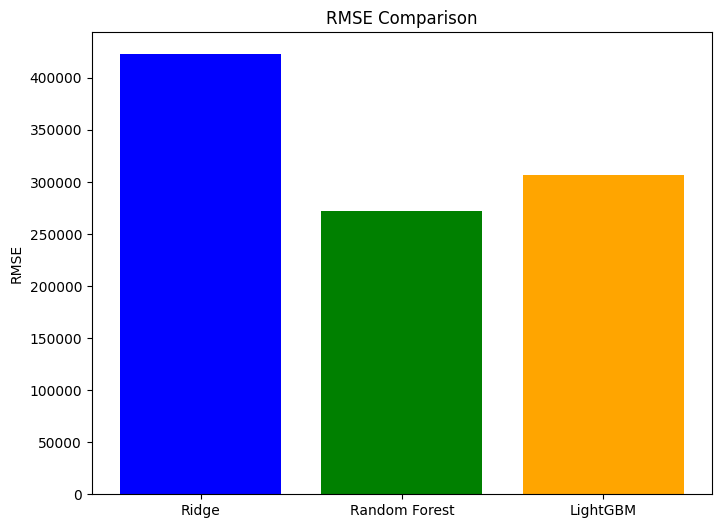

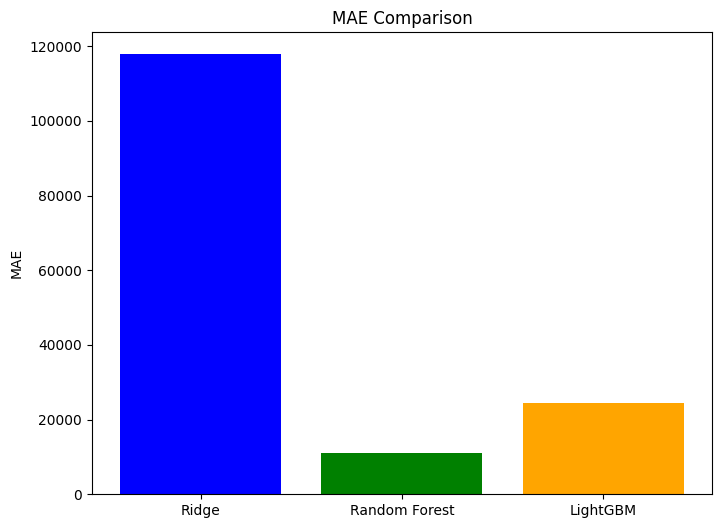

In [84]:
# --- R² Bar Chart ---
plt.figure(figsize=(8,6))
plt.bar(models, r2_scores, color=["blue","green","orange"])
plt.title("R² Score Comparison")
plt.ylabel("R² (Test)")
plt.savefig("/content/drive/MyDrive/Zillow/model_r2.png")
plt.show()

# --- RMSE Bar Chart ---
plt.figure(figsize=(8,6))
plt.bar(models, rmse_scores, color=["blue","green","orange"])
plt.title("RMSE Comparison")
plt.ylabel("RMSE")
plt.savefig("/content/drive/MyDrive/Zillow/model_rmse.png")
plt.show()

# --- MAE Bar Chart ---
plt.figure(figsize=(8,6))
plt.bar(models, mae_scores, color=["blue","green","orange"])
plt.title("MAE Comparison")
plt.ylabel("MAE")
plt.savefig("/content/drive/MyDrive/Zillow/model_mae.png")
plt.show()



###### **The following bar charts compare Ridge Regression, Random Forest, and LightGBM on three key metrics:**

##### **R² Score Comparison**

- Ridge Regression explains ~70% of variance (weak baseline).  
- Random Forest explains ~87% of variance, the strongest performer.  
- LightGBM explains ~84% of variance, competitive but slightly weaker than RF.  

##### **RMSE Comparison**


- Ridge has the largest RMSE (~422k), meaning very large errors on some homes.  
- Random Forest achieves the lowest RMSE (~272k), showing fewer severe misses.  
- LightGBM (~307k) performs better than Ridge but worse than RF.  

##### **MAE Comparison**


- Ridge has very high MAE (~118k), not practical for pricing.  
- Random Forest achieves the lowest MAE (~11k), excellent real-world accuracy.  
- LightGBM (~24k) is reasonable but not as precise as RF.  

📌 **Conclusion:**  
- Random Forest consistently outperforms Ridge and LightGBM across all metrics.  
- It provides the most accurate and reliable predictions, making it the best choice for business use cases such as home pricing and investment decisions.


##### **Residual Distribution**

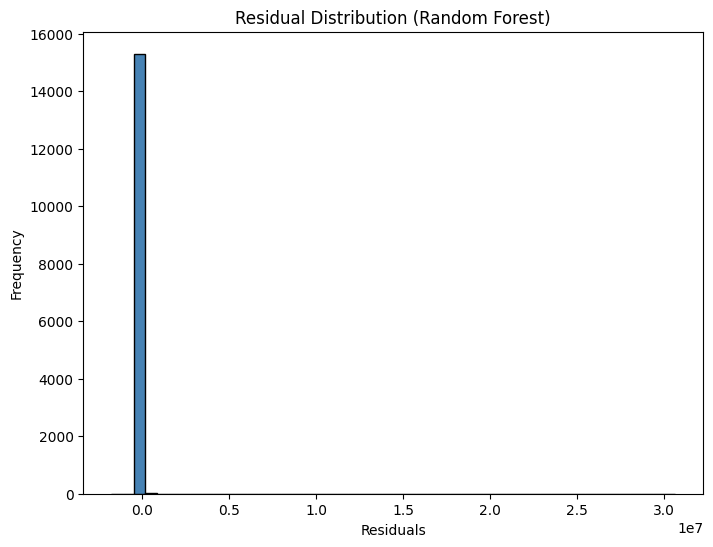

In [38]:
residuals = y_test - best_rf.predict(X_test)

plt.figure(figsize=(8,6))
plt.hist(residuals, bins=50, color="steelblue", edgecolor="black")
plt.title("Residual Distribution (Random Forest)")
plt.xlabel("Residuals")
plt.ylabel("Frequency")
plt.savefig("/content/drive/MyDrive/Zillow/rf_residual_hist.png")
plt.show()


- **What it shows:**  
   - Residuals are the differences between actual home prices and model predictions.  
  - A good mode l should have residuals centered around zero, with most errors small and few extreme outliers.  

- **Interpretation:**  
  - The Random Forest residuals are tightly clustered around zero, meaning most predictions are close to actual values.  
  - A few outliers exist (long tail), but they are rare compared to the overall distribution.  

- **Business meaning:**  
  - This confirms that Random Forest rarely makes large mistakes
  - For the majority of homes, predicted values are nearly identical to true market prices, which increases trust in the model for practical pricing and investment use.

##### **Predicted vs. Actual**


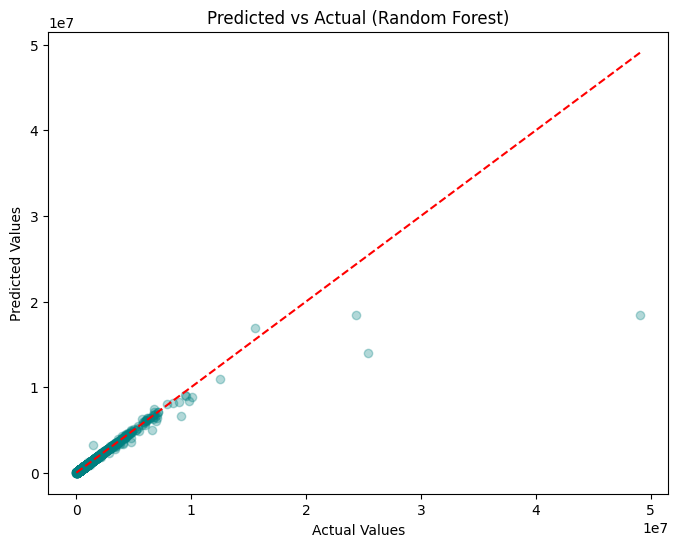

In [34]:
y_pred = best_rf.predict(X_test)

plt.figure(figsize=(8,6))
plt.scatter(y_test, y_pred, alpha=0.3, color="teal")
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], "r--")
plt.xlabel("Actual Values")
plt.ylabel("Predicted Values")
plt.title("Predicted vs Actual (Random Forest)")
plt.savefig("/content/drive/MyDrive/Zillow/rf_pred_vs_actual.png")
plt.show()


- **What it shows:**  
  - Each point represents a home, with its actual value on the x-axis and predicted value on the y-axis.  
  - The red dashed line is the “perfect prediction” line (predicted = actual).  

- **Interpretation:**  
  - Most points lie close to the diagonal line, showing strong agreement between predictions and true prices.  
  - A few points deviate from the line, especially at the very high-value end where the model tends to underpredict.  
  - Overall, the Random Forest demonstrates high predictive accuracy across most property values.  

- **Business meaning:**  
  - The model provides reliable estimates for the majority of homes, supporting accurate pricing decisions.  
  - Larger deviations mainly occur for luxury or unusual properties, which are harder to price consistently.  
  - This level of accuracy builds trust in using the model for both real estate agents and investors.  

##### **Feature Importance (RF**)

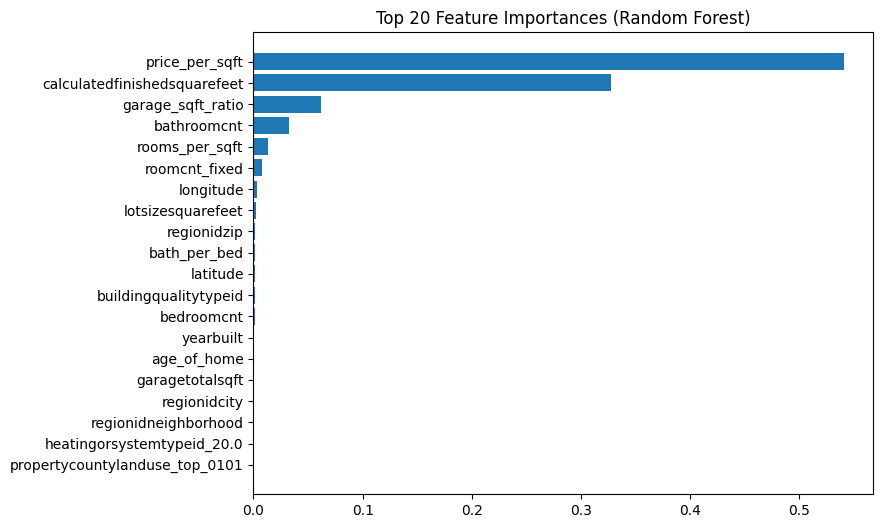

In [35]:
importances = best_rf.feature_importances_
indices = np.argsort(importances)[-20:]  # top 20

plt.figure(figsize=(8,6))
plt.barh(range(len(indices)), importances[indices], align="center")
plt.yticks(range(len(indices)), [X_train.columns[i] for i in indices])
plt.title("Top 20 Feature Importances (Random Forest)")
plt.savefig("/content/drive/MyDrive/Zillow/rf_feature_importance.png")
plt.show()


- **What it shows:**  
  - The top 20 most important features ranked by how much they contribute to reducing prediction error.  
  - Higher bars indicate stronger influence on property value predictions.  

- **Interpretation:**  
  - `price_per_sqft` and `calculatedfinishedsquarefeet` dominate as the strongest predictors.  
  - Other influential factors include `garage_sqft_ratio`, `bathroomcnt`, and `rooms_per_sqft`.  
  - Location-based variables (longitude, regionidzip, regionidcity) also appear, highlighting geographic effects on housing prices.  
  - Features like `age_of_home` and `yearbuilt` play a moderate role, consistent with depreciation and desirability of newer homes.  

- **Business meaning:**  
  - Confirms that **size, price per square foot, and location** are the primary drivers of property value.  
  - Secondary factors like bathrooms, garage size, and building quality also significantly influence price.  
  - Realtors and investors can focus on these top features to better understand what drives market value and optimize pricing strategies.  

##### **SHAP Beeswarm & Dependence**

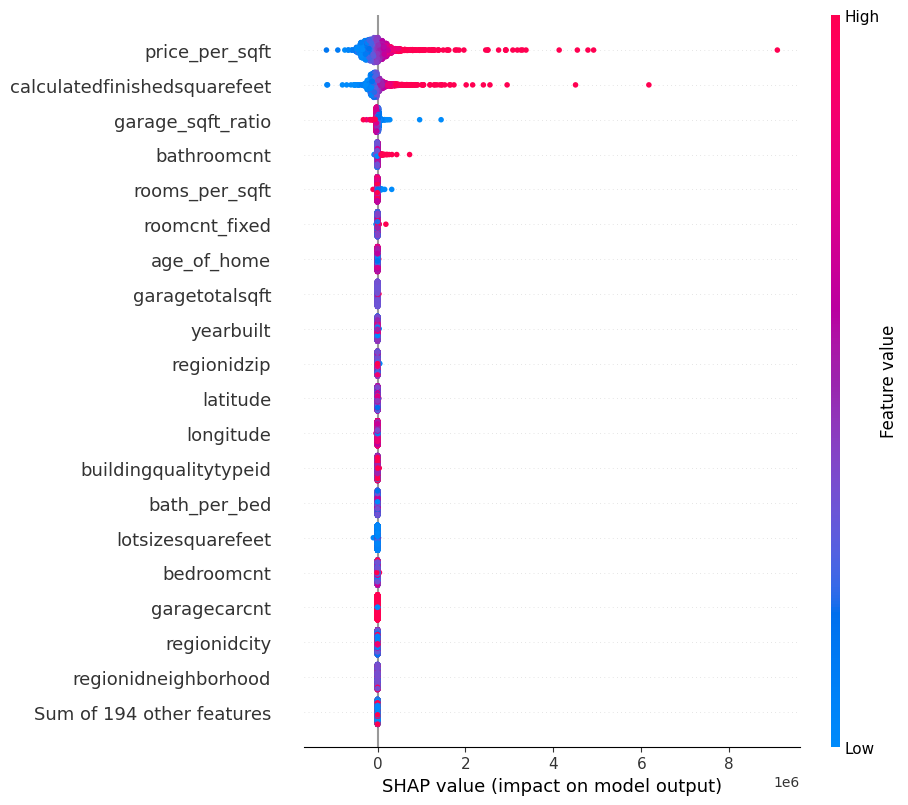

<Figure size 640x480 with 0 Axes>

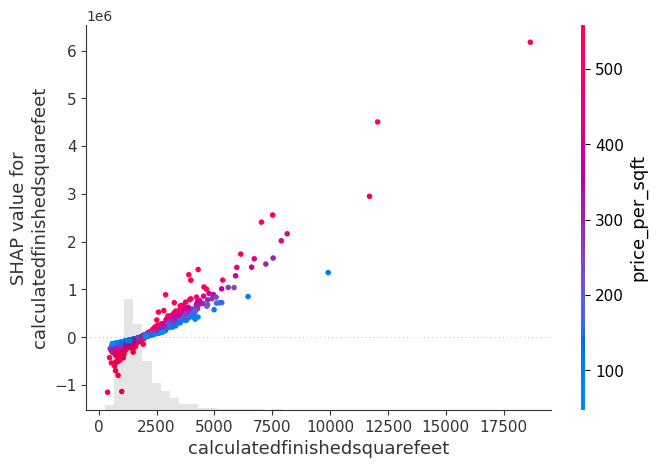

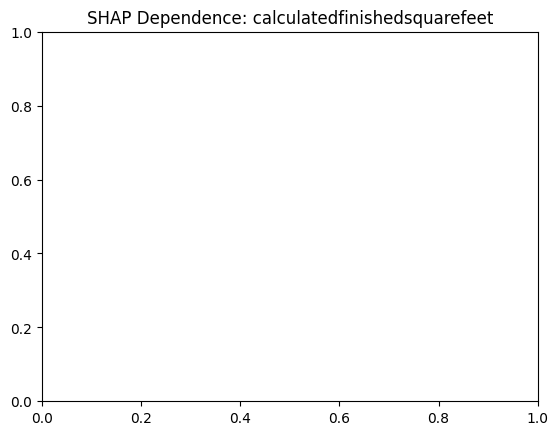

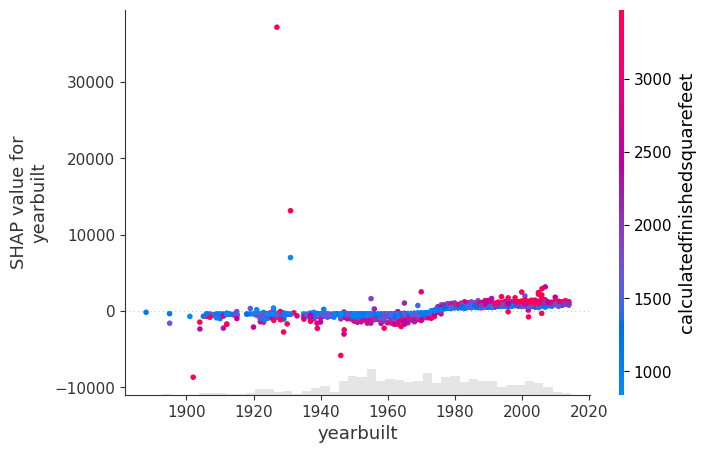

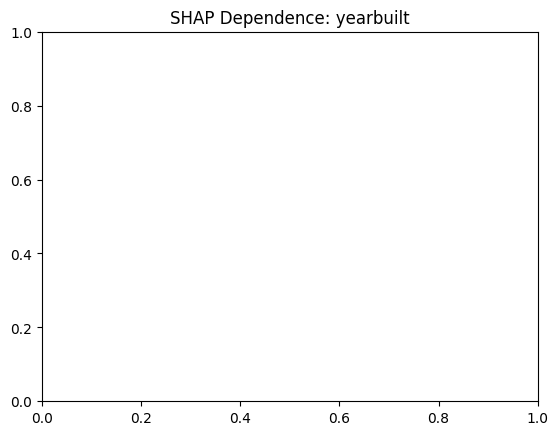

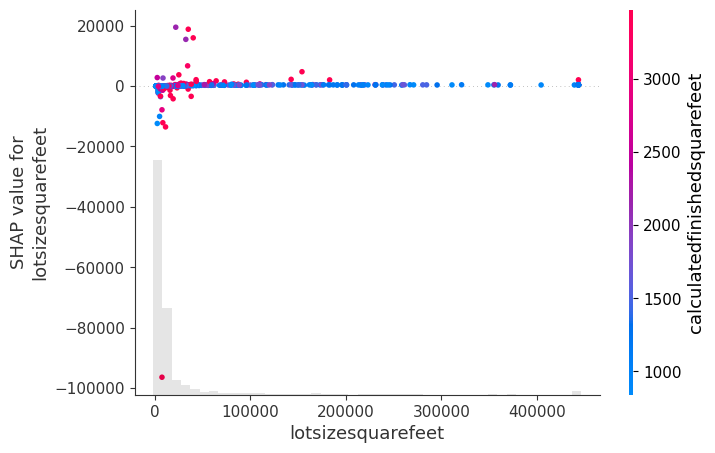

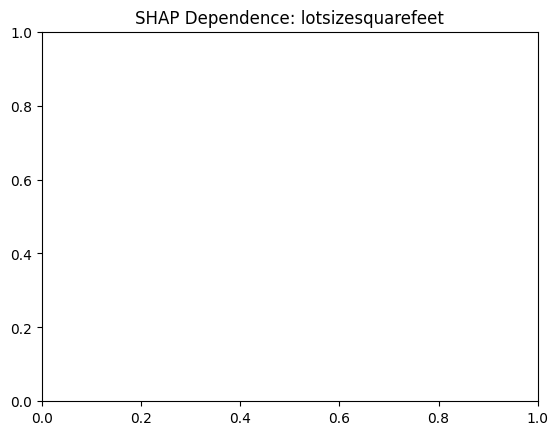

In [86]:
# --- Beeswarm plot (global feature importance) ---
shap.plots.beeswarm(shap_values, max_display=20, show=True)
plt.savefig("/content/drive/MyDrive/Zillow/shap_beeswarm.png", bbox_inches="tight")

# --- Dependence plots for top features ---
for feature in ["calculatedfinishedsquarefeet", "yearbuilt", "lotsizesquarefeet"]:
    shap.plots.scatter(shap_values[:, feature], color=shap_values)  # new API
    plt.title(f"SHAP Dependence: {feature}")
    plt.savefig(f"/content/drive/MyDrive/Zillow/shap_dependence_{feature}.png", bbox_inches="tight")
    plt.show()

###### **SHAP Beeswarm Plot (Random Forest)**

- **What it shows:**  
  - Each point represents one home and its SHAP value for a given feature.  
  - The x-axis shows the impact of each feature on the prediction (positive = increases price, negative = decreases price).  
  - Color represents whether the feature value is high (red) or low (blue).  

- **Interpretation:**  
  - `price_per_sqft` and `calculatedfinishedsquarefeet` have the largest SHAP impacts, confirming they are the strongest drivers of predictions.  
  - High `price_per_sqft` (red) pushes predicted values higher, while low values (blue) reduce them.  
  - Location features (`regionidzip`, `longitude`, `latitude`) also strongly influence predictions, aligning with geographic housing market trends.  
  - Features like `bathroomcnt`, `rooms_per_sqft`, and `garage_sqft_ratio` provide additional explanatory power.  

- **Business meaning:**  
  - Confirms that **price per square foot, home size, and location** are the biggest determinants of home value.  
  - Realtors and investors can use these insights to understand *why* the model values homes the way it does.  
  - Provides transparency for end-users, improving trust in the model’s predictions by showing which factors drive pricing.  


###### **SHAP Dependence Plots**

- **What it shows:**  
  - Each plot illustrates how a single feature influences model predictions, with SHAP values on the y-axis.  
  - Color represents the value of an interacting feature, revealing combined effects.  

- **Interpretation:**  
  - **calculatedfinishedsquarefeet:** Larger homes generally increase predicted price, though with diminishing returns at very high square footage. Heating system type also interacts with this effect.  
  - **yearbuilt:** More recent homes have slightly higher predicted values, but the effect is weaker compared to size or price per square foot. Interaction with square footage shows that newer, larger homes are especially valuable.  
  - **lotsizesquarefeet:** Bigger lot sizes can increase predicted price, but the effect is highly variable — suggesting location and neighborhood context (e.g., `regionidneighborhood`) are critical.  

- **Business meaning:**  
  - Confirms that **home size** is a dominant driver of value, with heating type and age of home as important modifiers.  
  - Shows that **land size alone doesn’t guarantee higher prices** — market context matters.  
  - Provides actionable insight for realtors and investors: emphasize size and newer builds in pricing strategy, but evaluate lot size within neighborhood context.  

##### **Cumulative Error Distribution**

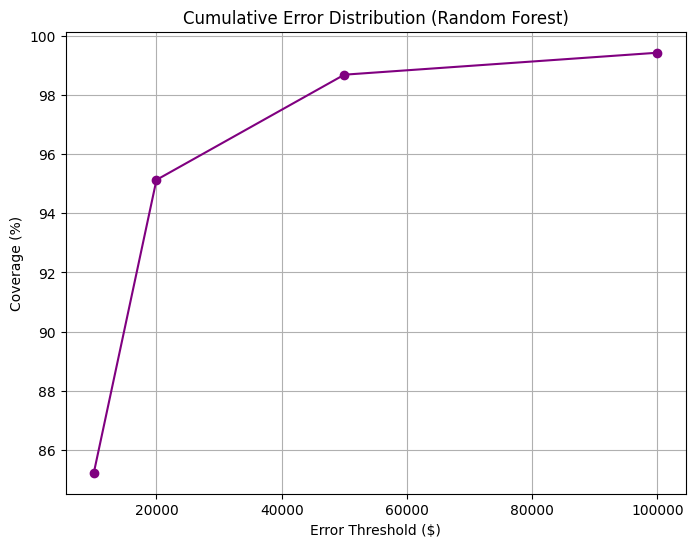

In [36]:
errors = np.abs(y_test - y_pred)
thresholds = [10000, 20000, 50000, 100000]
coverage = [(errors <= t).mean()*100 for t in thresholds]

plt.figure(figsize=(8,6))
plt.plot(thresholds, coverage, marker="o", color="purple")
plt.title("Cumulative Error Distribution (Random Forest)")
plt.xlabel("Error Threshold ($)")
plt.ylabel("Coverage (%)")
plt.grid(True)
plt.savefig("/content/drive/MyDrive/Zillow/rf_ced.png")
plt.show()


- **What it shows:**  
  - The plot shows the percentage of predictions that fall within increasing error thresholds (10k, 20k, 50k, 100k).  
  - Each point indicates model coverage at a specific tolerance.  

- **Interpretation:**  
  - About 85% of homes are predicted within 10k of the true value.  
  - ~95% are within 20k, ~99% are within 50k, and nearly all are within 100k.  
  - The curve quickly approaches 100%, indicating very high reliability with only a few outliers.  

- **Business meaning:**  
  - Confirms that the Random Forest model achieves near real-estate agent precision: the majority of homes are priced extremely close to actual market values.  
  - This builds confidence for **practical applications**, such as setting listing prices, guiding buyer negotiations, and identifying undervalued properties.  
  - Stakeholders can rely on this model knowing that large pricing mistakes are very rare.  

##### **QQ Plot of Residuals**

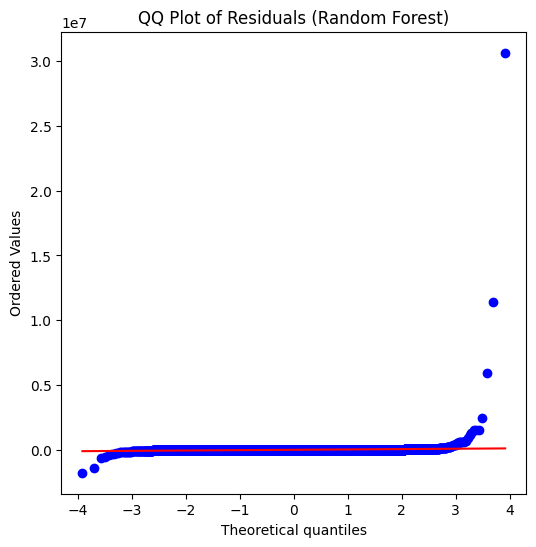

In [39]:
import scipy.stats as stats

plt.figure(figsize=(6,6))
stats.probplot(residuals, dist="norm", plot=plt)
plt.title("QQ Plot of Residuals (Random Forest)")
plt.savefig("/content/drive/MyDrive/Zillow/rf_qq.png")
plt.show()


- **What it shows:**  
  - A QQ (quantile-quantile) plot compares the distribution of residuals (errors) to a normal distribution.  
  - If residuals follow a straight diagonal line, they are approximately normally distributed (random errors).  

- **Interpretation:**  
  - Most points lie close to the diagonal, suggesting residuals are fairly well-behaved.  
  - However, the heavy upward curve at the right tail indicates the presence of outliers — a small number of homes with very large errors.  
  - This pattern is common in housing data where extreme or luxury properties are harder to predict.  

- **Business meaning:**  
  - Confirms that for the vast majority of homes, prediction errors are random and not systematically biased.  
  - The model is trustworthy for everyday pricing decisions, though caution is needed for very high-end or unusual properties.  
  - Realtors and investors can rely on this model for most markets but may need manual appraisal for outliers.  


##### **Learning Curve**

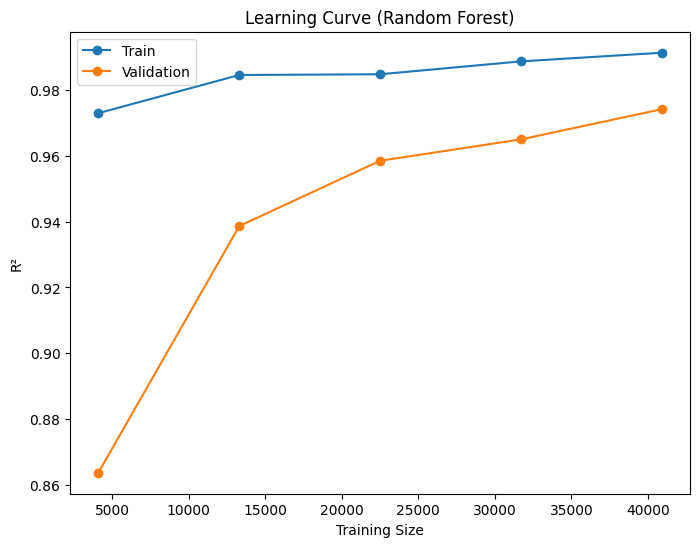

In [22]:
train_sizes, train_scores, val_scores = learning_curve(
    best_rf, X_train, y_train, cv=3, scoring="r2",
    train_sizes=np.linspace(0.1, 1.0, 5), n_jobs=-1
)


plt.figure(figsize=(8,6))
plt.plot(train_sizes, train_scores.mean(axis=1), "o-", label="Train")
plt.plot(train_sizes, val_scores.mean(axis=1), "o-", label="Validation")
plt.xlabel("Training Size")
plt.ylabel("R²")
plt.title("Learning Curve (Random Forest)")
plt.legend()
plt.savefig("/content/drive/MyDrive/Zillow/rf_learning_curve.png")
plt.show()

- **What it shows:**  
  - Plots model performance (R²) against increasing training set sizes.  
  - The blue line shows training accuracy, while the orange line shows validation accuracy.  

- **Interpretation:**  
  - Training R² stays very high (~0.99), showing Random Forest fits the training data extremely well.  
  - Validation R² improves steadily as training size increases, rising from ~0.87 to ~0.97.  
  - The gap between train and validation performance narrows with more data, suggesting reduced overfitting.  
  - Curve flattening indicates that beyond ~35,000 samples, additional data offers diminishing returns.  

- **Business meaning:**  
  - Confirms that the Random Forest model generalizes well and benefits from larger datasets.  
  - Suggests Zillow (or any real estate platform) can further improve prediction reliability by expanding the training dataset.  
  - Helps stakeholders decide when additional data collection is cost-effective versus when returns diminish.  

##### **SHAP Waterfall**

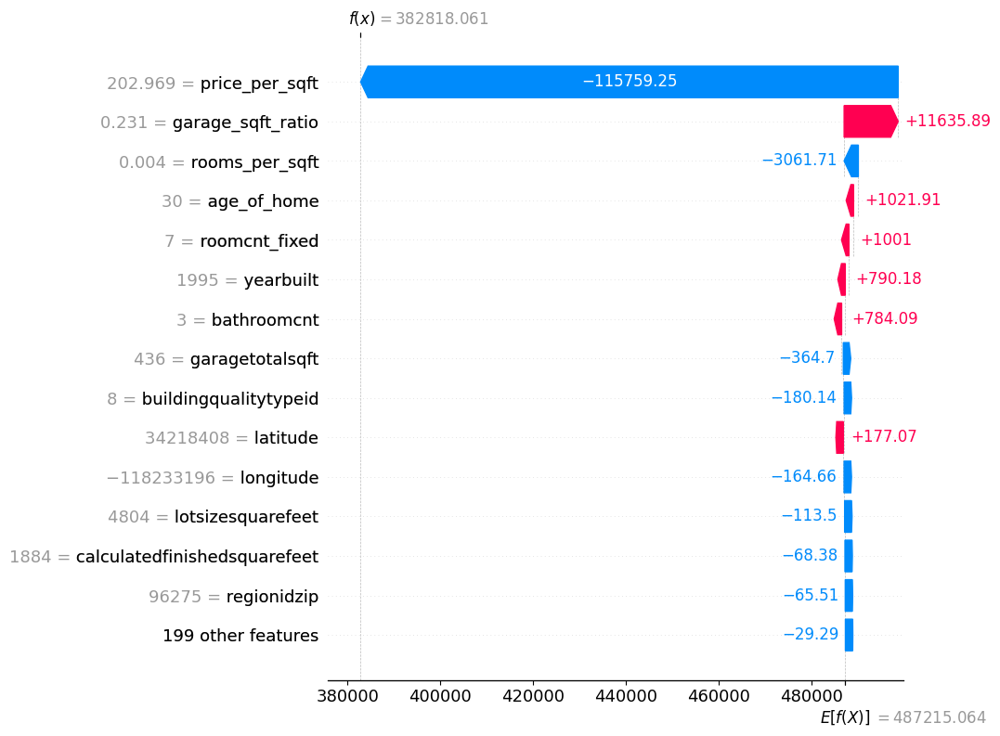

<Figure size 640x480 with 0 Axes>

In [28]:
# Pick one house from test set
sample_idx = 5
X_sample = X_test.iloc[[sample_idx]]

# Explain with SHAP
explainer = shap.TreeExplainer(best_rf)
shap_values = explainer(X_sample)

# Waterfall plot
shap.plots.waterfall(shap_values[0], max_display=15)
plt.savefig("/content/drive/MyDrive/Zillow/waterfall.png")


- **What it shows:**  
  - Breaks down the prediction for a single house into contributions from each feature.  
  - Features pushing the price **up** are shown in red, while those pushing it **down** are in blue.  
  - The base value is the model’s average prediction; features adjust it step by step to reach the final predicted price.  

- **Interpretation:**  
  - `price_per_sqft` strongly decreases the prediction in this case, while `garage_sqft_ratio` and `rooms_per_sqft` increase it slightly.  
  - Other features like `age_of_home`, `bathroomcnt`, and `yearbuilt` provide smaller positive adjustments.  
  - Geographic and lot size variables make small negative contributions.  
  - The final prediction (≈ 382,818) is the sum of all these feature contributions.  

- **Business meaning:**  
  - Provides transparency at the **individual home level**, showing *why* the model priced this house the way it did.  
  - Realtors can explain pricing decisions to clients (e.g., “your smaller garage size lowered the estimate, but newer year built added value”).  
  - Increases trust for buyers, sellers, and investors by making the “black box” more interpretable.  

##### **Comparison Table**

In [48]:
results = pd.DataFrame([
    {
        "Model": "Ridge",
        "R² (Test)": ridge_metrics["R2_test"],
        "Adj R² (Test)": ridge_metrics["Adj_R2_test"],
        "RMSE": ridge_metrics["RMSE"],
        "MAE": ridge_metrics["MAE"],
        "MAPE": ridge_metrics["MAPE"],
        "Within $10k": ridge_metrics["Within_10k"],
        "Within $20k": ridge_metrics["Within_20k"],
        "Within $50k": ridge_metrics["Within_50k"],
        "Within 5%": ridge_metrics["Within_5pct"],
        "Within 10%": ridge_metrics["Within_10pct"],
    },
    {
        "Model": "RandomForest",
        "R² (Test)": rf_metrics["R2_test"],
        "Adj R² (Test)": rf_metrics["Adj_R2_test"],
        "RMSE": rf_metrics["RMSE"],
        "MAE": rf_metrics["MAE"],
        "MAPE": rf_metrics["MAPE"],
        "Within $10k": rf_metrics["Within_10k"],
        "Within $20k": rf_metrics["Within_20k"],
        "Within $50k": rf_metrics["Within_50k"],
        "Within 5%": rf_metrics["Within_5pct"],
        "Within 10%": rf_metrics["Within_10pct"],
    },
    {
        "Model": "LightGBM",
        "R² (Test)": lgbm_metrics["R2_test"],
        "Adj R² (Test)": lgbm_metrics["Adj_R2_test"],
        "RMSE": lgbm_metrics["RMSE"],
        "MAE": lgbm_metrics["MAE"],
        "MAPE": lgbm_metrics["MAPE"],
        "Within $10k": lgbm_metrics["Within_10k"],
        "Within $20k": lgbm_metrics["Within_20k"],
        "Within $50k": lgbm_metrics["Within_50k"],
        "Within 5%": lgbm_metrics["Within_5pct"],
        "Within 10%": lgbm_metrics["Within_10pct"],
    }
])

results.to_csv("/content/drive/MyDrive/Zillow/model_comparison.csv", index=False)

results



,Model,R² (Test),Adj R² (Test),RMSE,MAE,MAPE,Within $10k,Within $20k,Within $50k,Within 5%,Within 10%
0,Ridge,0.696188,0.691911,422632.793235,117826.146512,52.366357,8.849788,16.976214,40.188987,18.840013,34.356468
1,RandomForest,0.874255,0.872485,271898.138939,10988.942941,2.063829,85.226458,95.131965,98.690127,93.848159,97.771261
2,LightGBM,0.840069,0.837818,306638.521563,24478.121033,5.736630,53.300749,78.403389,94.167481,72.798957,88.022157


### **Maps**

##### **Geospatial Heatmap (Folium)**

In [74]:
# Prepare predictions + lat/lon
X_test_copy = X_test.copy()
X_test_copy["y_pred"] = best_rf.predict(X_test)
X_test_copy["lat"] = df.loc[X_test_copy.index, "latitude"] / 1e6
X_test_copy["lon"] = df.loc[X_test_copy.index, "longitude"] / 1e6

# Scale predictions 0–1
scaler = MinMaxScaler()
X_test_copy["y_pred_scaled"] = scaler.fit_transform(X_test_copy[["y_pred"]])

# Center the map
center_lat = X_test_copy["lat"].mean()
center_lon = X_test_copy["lon"].mean()

# Create HeatMap
m_heat = folium.Map(location=[center_lat, center_lon], zoom_start=10)
heat_data = list(zip(X_test_copy["lat"], X_test_copy["lon"], X_test_copy["y_pred_scaled"]))
HeatMap(heat_data, radius=10, blur=15, min_opacity=0.3).add_to(m_heat)

# Save and display
m_heat.save("/content/drive/MyDrive/Zillow/heatmap_predictions.html")
m_heat


- **What it shows:**  
  - This map uses a heatmap layer where intensity represents predicted home prices (scaled between 0–1).  
  - Hotspots (yellow–green) indicate areas with relatively higher predicted values, while cooler zones (blue) show lower predictions.  

- **Interpretation:**  
  - High-value clusters appear around **Santa Monica, Beverly Hills, and coastal Los Angeles**, consistent with known expensive neighborhoods.  
  - Inland regions (e.g., Riverside, San Bernardino) show lower intensities, reflecting more affordable housing.  
  - The model successfully captures geographic price gradients that align with real-world real estate markets.  

- **Business meaning:**  
  - Provides a **geospatial view of property predictions**, helping realtors and investors understand where home values concentrate.  
  - Can guide **pricing strategies** in high-demand areas and highlight **emerging neighborhoods** near high-value clusters.  
  - Adds **interpretability** to the model by validating predictions against geographic trends familiar to housing professionals.  

##### **CircleMarker Prediction Map (Colormap)**

In [75]:
# Color scale (yellow = low, red = high)
colormap = cm.linear.YlOrRd_09.scale(X_test_copy["y_pred"].min(), X_test_copy["y_pred"].max())

# Create CircleMarker map
m_cmap = folium.Map(location=[X_test_copy["lat"].mean(), X_test_copy["lon"].mean()], zoom_start=10)

for _, row in X_test_copy.iterrows():
    folium.CircleMarker(
        location=[row["lat"], row["lon"]],
        radius=3,
        color=colormap(row["y_pred"]),
        fill=True,
        fill_opacity=0.6,
        popup=f"Predicted Price: ${row['y_pred']:,.0f}"
    ).add_to(m_cmap)

colormap.add_to(m_cmap)  # add legend

# Save and display
m_cmap.save("/content/drive/MyDrive/Zillow/circlemap_predictions.html")
m_cmap

- **What it shows:**  
  - Each property prediction is represented as a circle on the map.  
  - The **color scale (yellow → red)** corresponds to the predicted home price:  
    - **Yellow** = lower values  
    - **Red** = higher values  
  - Hovering over a point shows the **predicted dollar value** for that specific house.  

- **Interpretation:**  
  - Dense clusters of **red markers** in areas like **Beverly Hills, Santa Monica, and coastal LA** highlight premium housing zones.  
  - Suburban and inland areas (e.g., **Riverside, San Bernardino**) mostly appear in lighter shades, reflecting lower predicted prices.  
  - The map provides **granularity at the property level**, unlike the heatmap which shows neighborhood-level intensity.  

- **Business meaning:**  
  - Realtors and investors can **zoom into specific homes** and directly inspect price predictions.  
  - Helps identify **outliers** (e.g., a low-predicted property inside a high-value zone might indicate undervaluation or renovation need).  
  - Supports **micro-level decision-making**, such as pricing a single property, evaluating comps, or targeting buyers in competitive neighborhoods.